# Result Visualizer

Different visualizations of anomaly detection result, including forecasts, reconstructions, anomaly scores, predicted and actual anomalies

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import os
import pickle
from sklearn.metrics import f1_score, precision_score, recall_score
import plotly as py
from plotly.offline import download_plotlyjs, init_notebook_mode
import plotly.graph_objs as go
import cufflinks as cf
import glob
import sys
import json
import more_itertools as mit
from tqdm.notebook import tqdm
cf.go_offline()
init_notebook_mode

sys.path.insert(0, '.')
from plotting import Plotter

In [3]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:95% !important; }</style>"))

### Provide what output to visualize
In case of multiple models trained for the same dataset, they will be saved in different folders named using the datetime of training.
Use 'model_id' to specify which to load, '-1' for latest, '-2' for second latest, etc, or you can specify the exact datetime. 

In [150]:
res_path = './output/ASC'
# res_path = './output/MSL'
#res_path = './output/SMAP'
#res_path = './output/SMD/1-1'

In [151]:
plotter = Plotter(res_path, model_id='-1')
plotter.result_summary()
print(plotter.result_path)

Loading results of ./output/ASC/29112021_212815
Result summary:
Epsilon:
		precision: 0.61, recall: 1.00, F1: 0.75
POT:
		precision: 0.77, recall: 1.00, F1: 0.87
Brute-Force:
		precision: 0.88, recall: 1.00, F1: 0.94
./output/ASC/29112021_212815


In [152]:
plotter.pred_cols = ["feat_0"]
print(plotter.pred_cols)

['feat_0']


## Interactive plot 
- Interactive plot of forecastings, reconstructions,actual values, errors, etc of the specified feature.
- Params:
    - ```feature```: which feature to visualize
    - ```plot_train```: whether to also plot for train set
    - ```plot_errors```: whether to plot anomaly scores (error) for the feature
    - ```plot_feature_anom```: if True, the feature-wise threshold and anomaly prediction is included
    - ```start```: start index of dataset
    - ```end```: end index of dataset

If ```plot_feature_anom``` is set to True:
- Predicted anomalies (for the particular feature) are visualized by a light blue rectangle.
- As we only predict one feature for SMAP and MSL, the actual (true) anomalies are included using a red rectangle, making correctly predicted anomalies purple.


In [153]:
# plotter.plot_feature(
#     feature=0, 
#     plot_train=True, 
#     plot_errors=True, 
#     plot_feature_anom=True,
#     start=1463*4, 
#     end=1463*5
# )
plotter.plot_feature(
    feature=0, 
    plot_train=True, 
    plot_errors=True, 
    plot_feature_anom=True,

)

### Global (entity-level) Anomaly Predictions 
```plot_global_predictions``` and ```plotly_global_predictions``` visualize the entity-level anomaly scores which are used to make anomaly predictions at entity-level.
In ```plotly_global_predictions```:
- Actual (true) anomalies are visualized by a red rectangle
- Predicted anomalies are visualized by a blue rectangle. 
- Thus, if anomalies are predicted correctly the color of the rectangle will be purple. 

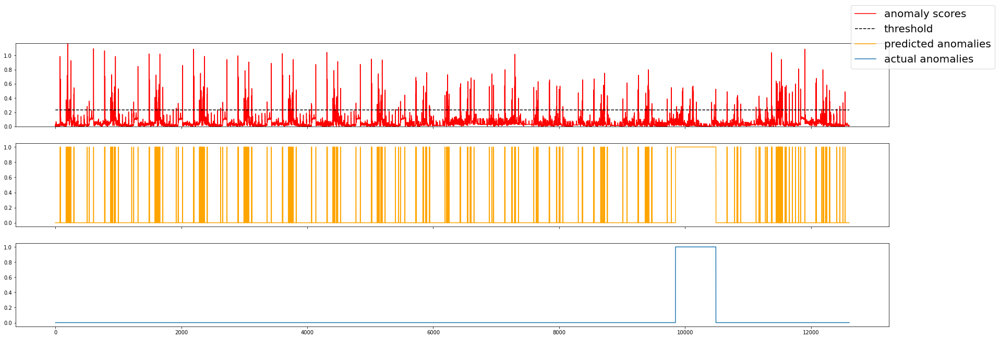

In [154]:
plotter.plot_global_predictions(type="test")

In [155]:
plotter.plotly_global_predictions(type="test")

<Figure size 432x288 with 0 Axes>

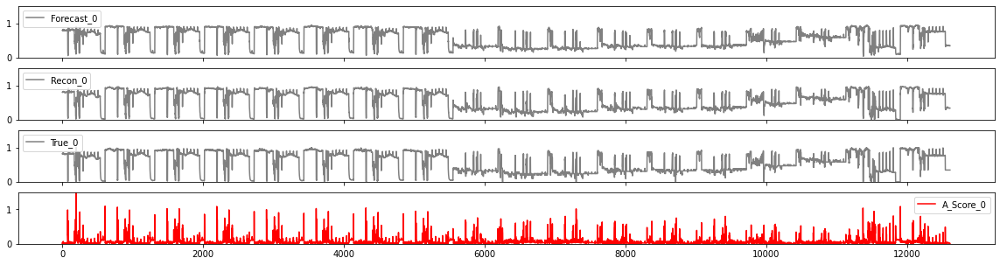

In [156]:
plotter.plot_all_features(type='test')

In [111]:
print(plotter.pred_cols)

None


In [158]:
# plotter.plot_anomaly_segments()

In [168]:
att_test = pd.read_pickle(plotter.result_path + '/test_att.pkl')
att_train = pd.read_pickle(plotter.result_path + '/train_att.pkl')

In [171]:
len(att_train[0][0])

18

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


[Text(0.5, 0, 'NO.1_Gas'),
 Text(1.5, 0, 'NO.2_Gas'),
 Text(2.5, 0, 'NO.3_Gas'),
 Text(3.5, 0, 'NO.4_Gas'),
 Text(4.5, 0, 'NO.5_Gas'),
 Text(5.5, 0, 'NO.6_Gas'),
 Text(6.5, 0, 'NO.7_Gas'),
 Text(7.5, 0, 'NO.8_Gas'),
 Text(8.5, 0, 'NO.1_Scav'),
 Text(9.5, 0, 'NO.2_Scav'),
 Text(10.5, 0, 'NO.3_Scav'),
 Text(11.5, 0, 'NO.4_Scav'),
 Text(12.5, 0, 'NO.5_Scav'),
 Text(13.5, 0, 'NO.6_Scav'),
 Text(14.5, 0, 'NO.7_Scav'),
 Text(15.5, 0, 'NO.8_Scav'),
 Text(16.5, 0, 'LOAD'),
 Text(17.5, 0, 'RPM')]

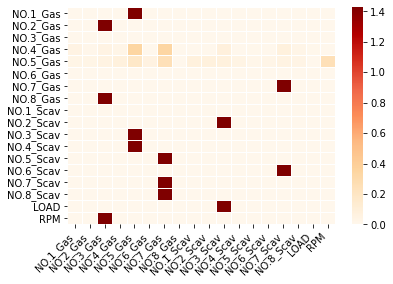

In [218]:
import numpy as np
import seaborn as sns
import matplotlib.pylab as plt
print(att_train[-50][0][0])
# x_axis_labels = y_axis_labels = ['NO.1_Gas', 'NO.2_Gas', 'NO.3_Gas', 'NO.4_Gas', 'NO.5_Gas', 'NO.6_Gas', 'NO.1_Scav', 'NO.2_Scav', 'NO.3_Scav','NO.4_Scav', 'NO.5_Scav', 'NO.6_Scav', 'LOAD', 'RPM']
x_axis_labels = y_axis_labels = ['NO.1_Gas', 'NO.2_Gas', 'NO.3_Gas', 'NO.4_Gas', 'NO.5_Gas', 'NO.6_Gas', 'NO.7_Gas', 'NO.8_Gas', 'NO.1_Scav', 'NO.2_Scav', 'NO.3_Scav','NO.4_Scav', 'NO.5_Scav', 'NO.6_Scav', 'NO.7_Scav', 'NO.8_Scav', 'LOAD', 'RPM']

uniform_data = np.array(att_train[29][20])
ax = sns.heatmap(uniform_data, linewidth=0.5, xticklabels=x_axis_labels, yticklabels=y_axis_labels, cmap='OrRd')
# plt.show()
# ax.tick_params(axis='x', rotation=45)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, horizontalalignment='right')

In [213]:
print(len(att_test[0]))

256


[Text(0.5, 0, 'NO.1_Gas'),
 Text(1.5, 0, 'NO.2_Gas'),
 Text(2.5, 0, 'NO.3_Gas'),
 Text(3.5, 0, 'NO.4_Gas'),
 Text(4.5, 0, 'NO.5_Gas'),
 Text(5.5, 0, 'NO.6_Gas'),
 Text(6.5, 0, 'NO.7_Gas'),
 Text(7.5, 0, 'NO.8_Gas'),
 Text(8.5, 0, 'NO.1_Scav'),
 Text(9.5, 0, 'NO.2_Scav'),
 Text(10.5, 0, 'NO.3_Scav'),
 Text(11.5, 0, 'NO.4_Scav'),
 Text(12.5, 0, 'NO.5_Scav'),
 Text(13.5, 0, 'NO.6_Scav'),
 Text(14.5, 0, 'NO.7_Scav'),
 Text(15.5, 0, 'NO.8_Scav'),
 Text(16.5, 0, 'LOAD'),
 Text(17.5, 0, 'RPM')]

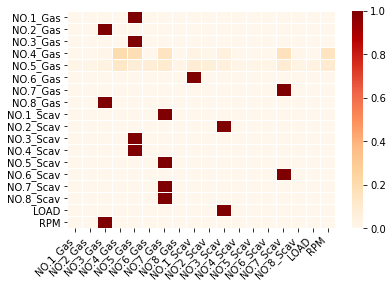

In [222]:
uniform_data = np.array(att_test[5][-1])
ax = sns.heatmap(uniform_data, linewidth=0.5, xticklabels=x_axis_labels, yticklabels=y_axis_labels, cmap='OrRd')

ax.set_xticklabels(ax.get_xticklabels(), rotation=45, horizontalalignment='right')

In [163]:
plotter.test_output

,Forecast_0,Recon_0,True_0,A_Score_0,A_Score_Global,A_Pred_0,Thresh_0,A_True_Global,Thresh_Global,A_Pred_Global,timestamp
0,0.797199,0.803900,0.812987,0.024875,0.024875,0,0.665615,False,0.233584,0,0
1,0.805127,0.805422,0.810390,0.010231,0.010231,0,0.665615,False,0.233584,0,1
2,0.801664,0.801254,0.802597,0.002276,0.002276,0,0.665615,False,0.233584,0,2
3,0.794956,0.805305,0.812987,0.025713,0.025713,0,0.665615,False,0.233584,0,3
4,0.805394,0.805617,0.807792,0.004573,0.004573,0,0.665615,False,0.233584,0,4
...,...,...,...,...,...,...,...,...,...,...,...
12603,0.348449,0.335894,0.342466,0.012555,0.012555,0,0.665615,False,0.233584,0,12603
12604,0.350509,0.334812,0.342466,0.015697,0.015697,0,0.665615,False,0.233584,0,12604
12605,0.351994,0.334769,0.342466,0.017225,0.017225,0,0.665615,False,0.233584,0,12605
12606,0.351770,0.336537,0.342466,0.015233,0.015233,0,0.665615,False,0.233584,0,12606
